# Import library

In [248]:
import osmnx as ox
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Import data

## Green space from landuse key

In [249]:
# green_landuse_area = gpd.read_file('../data/raw/osm/green space/green_landuse_area.geojson')
green_landuse_area = gpd.read_file('../data/raw/osm/green space/green_landuse_area_dresden.geojson')

In [250]:
green_landuse_area = green_landuse_area.to_crs(epsg=32633)

In [251]:
green_landuse_area.columns

Index(['element', 'id', 'landuse', 'name', 'denomination', 'religion',
       'wikidata', 'check_date:opening_hours', 'opening_hours', 'website',
       ...
       'substance', 'utility', 'was:man_made', 'name:en', 'level', 'material',
       'type', 'name:hsb', 'source:outline', 'geometry'],
      dtype='object', length=126)

In [252]:
green_landuse_area = green_landuse_area[['element', 'id', 'landuse', 
                                         'name', 'barrier', 'note', 
                                         'opening_hours', 'access', 'description', 
                                         'leisure', 'tourism', 'surface', 
                                         'landcover', 'amenity', 'natural', 
                                         'type', 'geometry']]

In [253]:
green_landuse_area['area'] = green_landuse_area['geometry'].area

In [254]:
green_landuse_area['access'].unique()

array([None, 'private', 'yes'], dtype=object)

In [255]:
print('total rows:', green_landuse_area.shape[0])  # number of rows
for i in green_landuse_area['access'].unique():
    if i == None:
        print('access is None:', green_landuse_area[green_landuse_area['access'].isnull()].shape[0])
    else:
        # print number of rows that has access e.g. private,yes,none or others
        print('access is', i , ':', green_landuse_area[green_landuse_area['access']==i].shape[0])

total rows: 12620
access is None: 12593
access is private : 26
access is yes : 1


In [256]:
green_landuse_area['type'].unique()

array([None, 'multipolygon'], dtype=object)

In [257]:
green_landuse_area['geometry'].type.unique()

array(['Point', 'MultiPolygon', 'Polygon'], dtype=object)

In [258]:
# check all unique values in every columns
temp_column_list = ['landuse', 'barrier', 'access', 
                    'leisure', 'tourism', 'surface', 
                    'landcover', 'amenity', 'natural']
for i in temp_column_list:
    print(i, ":", green_landuse_area[i].unique())

landuse : ['meadow' 'forest' 'allotments' 'grass' 'cemetery' 'recreation_ground'
 'vineyard' 'greenfield' 'orchard' 'village_green']
barrier : [None 'fence' 'wall' 'hedge']
access : [None 'private' 'yes']
leisure : [None 'park' 'water_park' 'playground' 'garden' 'pitch']
tourism : [None 'attraction' 'zoo']
surface : [None 'grass' 'gravel']
landcover : [None 'trees' 'grass' 'bushes' 'bare_ground']
amenity : [None 'grave_yard' 'parking']
natural : [None 'scrub' 'grassland' 'wetland' 'wood' 'water' 'plant']


## Green space from leisure key

In [259]:
# green_leisure_area = gpd.read_file('../data/raw/osm/green space/green_leisure_area.geojson')
green_leisure_area = gpd.read_file('../data/raw/osm/green space/green_leisure_area_dresden.geojson')

In [260]:
green_leisure_area = green_leisure_area.to_crs(epsg=32633)

In [261]:
green_leisure_area.columns

Index(['element', 'id', 'created_by', 'leisure', 'wheelchair', 'access',
       'name', 'opening_hours', 'operator', 'sport',
       ...
       'name:de', 'pitch:net', 'pitch:net:material', 'pitch:net:overhang',
       'construction', 'operator:short', 'animal_training', 'type', 'name:fr',
       'geometry'],
      dtype='object', length=149)

In [262]:
green_leisure_area['charge'].unique()

array([None, '8-14€ pro Stunde und Feld'], dtype=object)

In [263]:
green_leisure_area = green_leisure_area[['element', 'id', 'access', 
                                         'leisure', 'name', 'opening_hours', 'indoor',
                                         'operator', 'description', 'playground',
                                         'note', 'surface', 'fee', 
                                         'barrier', 'landuse', 'natural',
                                         'charge', 'landcover', 'fence_type', 'garden:type',
                                         'wall', 'type', 'geometry']]

In [264]:
green_leisure_area['area'] = green_leisure_area['geometry'].area

In [265]:
green_leisure_area['access'].unique()

array([None, 'yes', 'private', 'customers', 'permissive', 'no', 'unknown',
       'permit', 'school'], dtype=object)

In [266]:
print('total rows:', green_leisure_area.shape[0])  # number of rows
for i in green_leisure_area['access'].unique():
    if i == None:
        print('access is None:', green_leisure_area[green_leisure_area['access'].isnull()].shape[0])
    else:
        # print number of rows that has access e.g. private,yes,none or others
        print('access is', i , ':', green_leisure_area[green_leisure_area['access']==i].shape[0])

total rows: 3963
access is None: 2669
access is yes : 674
access is private : 459
access is customers : 103
access is permissive : 37
access is no : 8
access is unknown : 1
access is permit : 11
access is school : 1


In [267]:
# check all unique values in every columns
temp_column_list = ['access', 'leisure', 'indoor',
                    'playground', 'surface', 'fee', 
                    'barrier', 'landuse', 'natural',
                    'charge', 'landcover', 'fence_type', 
                    'garden:type', 'wall']
for i in temp_column_list:
    print(i, ":", green_leisure_area[i].unique())

access : [None 'yes' 'private' 'customers' 'permissive' 'no' 'unknown' 'permit'
 'school']
leisure : ['playground' 'pitch' 'garden' 'dog_park' 'park' 'nature_reserve'
 'golf_course']
indoor : [None 'yes' 'no']
playground : [None 'climbingframe' 'swing;sandpit' 'tabletop_football' 'teenshelter'
 'springy' 'sandpit' 'slide' 'sandpit;swingy' 'water' 'climbingwall'
 'climbingframe;sandpit' 'climbingframe;swing' 'swing' 'zipwire'
 'roundabout']
surface : [None 'sand' 'concrete' 'grass' 'unpaved' 'dirt' 'ground' 'paved'
 'compacted' 'tartan' 'artificial_turf' 'clay' 'asphalt' 'fine_gravel'
 'paving_stones' 'gravel' 'rubber' 'sett' 'wood' 'pebblestone' 'woodchips'
 'decoturf' 'textile' 'dirt/sand' 'acrylic' 'textile_chips']
fee : [None 'no' 'yes']
barrier : [None 'fence' 'wall' 'hedge']
landuse : [None 'forest' 'grass' 'recreation_ground' 'residential' 'greenfield'
 'construction']
natural : [None 'scrub' 'wood']
charge : [None '8-14€ pro Stunde und Feld']
landcover : [None 'gravel']
fence_ty

### remove indoor space (maybe later?)

In [268]:
# green_leisure_area_new = green_leisure_area[green_leisure_area['indoor']!='yes']

In [269]:
# green_leisure_area[green_leisure_area['indoor']=='yes'][['access', 'geometry']].explore()

## Green space from nature key

In [270]:
# green_natural_area = gpd.read_file('../data/raw/osm/green space/green_natural_area.geojson')
green_natural_area = gpd.read_file('../data/raw/osm/green space/green_natural_area_dresden.geojson')

In [271]:
green_natural_area = green_natural_area.to_crs(epsg=32633)

In [272]:
green_natural_area.columns

Index(['element', 'id', 'natural', 'wetland', 'name', 'source:name',
       'old_name', 'source', 'boundary', 'denotation', 'protect_class',
       'protection_title', 'wikidata', 'wikipedia', 'leaf_type', 'landuse',
       'note', 'image', 'created_by', 'alt_name', 'intermittent', 'salt',
       'leisure', 'leaf_cycle', 'fenced', 'fruit', 'trees', 'description:de',
       'attraction', 'name:cs', 'species:de', 'species:wikidata', 'wheelchair',
       'fixme', 'tourism', 'barrier', 'fence_type', 'ref', 'start_date',
       'description', 'FIXME', 'historic', 'resource', 'place', 'tidal',
       'survey:date', 'addr:city', 'addr:country', 'addr:housenumber',
       'addr:postcode', 'addr:street', 'abandoned:landuse',
       'short_protection_title', 'basin', 'embankment', 'landcover',
       'operator', 'height', 'disused', 'disused:leisure', 'surface',
       'old_name:cs', 'fence', 'level', 'operator:wikidata', 'man_made',
       'layer', 'seasonal', 'meadow', 'access', 'comment', 'ar

In [273]:
green_natural_area['comment'].unique()

array([None,
       'Mitte November 2018 startete eine heftige Baggeraktivität hier'],
      dtype=object)

In [274]:
green_natural_area = green_natural_area[['element', 'id', 'natural', 
                                         'name', 'note', 'leisure',
                                         'description', 'barrier', 'landuse',
                                         'landcover', 'access', 'fee', 'type', 'geometry']]

In [275]:
green_natural_area['area'] = green_natural_area['geometry'].area

In [276]:
green_natural_area['access'].unique()

array([None, 'private', 'yes'], dtype=object)

In [277]:
print('total rows:', green_natural_area.shape[0])  # number of rows
for i in green_natural_area['access'].unique():
    if i == None:
        print('access is None:', green_natural_area[green_natural_area['access'].isnull()].shape[0])
    else:
        # print number of rows that has access e.g. private,yes,none or others
        print('access is', i , ':', green_natural_area[green_natural_area['access']==i].shape[0])

total rows: 4610
access is None: 4606
access is private : 1
access is yes : 3


In [278]:
# check all unique values in every columns
temp_column_list = ['natural', 'leisure', 'barrier', 'landuse', 'landcover', 'access', 'fee']
for i in temp_column_list:
    print(i, ":", green_natural_area[i].unique())

natural : ['wetland' 'wood' 'scrub' 'grassland' 'heath']
leisure : [None 'nature_reserve']
barrier : [None 'fence' 'wall']
landuse : [None 'forest' 'greenfield' 'basin' 'grass' 'allotments' 'meadow'
 'railway' 'brownfield' 'residential']
landcover : [None 'grass' 'trees' 'scrub' 'bsuhes' 'bushes']
access : [None 'private' 'yes']
fee : [None 'no']


## Green space from camp site

In [279]:
# green_campsite_area = gpd.read_file('../data/raw/osm/green space/green_campsite_area.geojson')
green_campsite_area = gpd.read_file('../data/raw/osm/green space/green_campsite_area_dresden.geojson')

In [280]:
green_campsite_area = green_campsite_area.to_crs(epsg=32633)

In [281]:
green_campsite_area.head()

,element,id,created_by,tourism,access,addr:city,addr:country,addr:housenumber,addr:postcode,addr:street,...,motor_vehicle,beds,group_only,guest_house,rooms,attraction,capacity:disabled,seasonal,socket:cee_blue,geometry
0,node,257564076,JOSM,picnic_site,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,POINT (411597.918 5665030.941)
1,node,257564078,JOSM,picnic_site,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,POINT (411626.748 5664796.911)
2,node,257922815,JOSM,picnic_site,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,POINT (411564.728 5665084.269)
3,node,257923367,None,picnic_site,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,POINT (411586.657 5667217.952)
4,node,258326088,None,camp_site,private,Dresden,DE,81,01277,Tolkewitzer Straße,...,None,None,None,None,None,None,None,None,None,POINT (417186.97 5654969.5)


In [282]:
green_campsite_area['area'] = green_campsite_area['geometry'].area

In [283]:
print('total rows:', green_campsite_area.shape[0])  # number of rows
for i in green_campsite_area['access'].unique():
    if i == None:
        print('access is None:', green_campsite_area[green_campsite_area['access'].isnull()].shape[0])
    else:
        # print number of rows that has access e.g. private,yes,none or others
        print('access is', i , ':', green_campsite_area[green_campsite_area['access']==i].shape[0])

total rows: 199
access is None: 183
access is private : 7
access is yes : 3
access is customers : 5
access is permit : 1


## POI/Amenity from amenity 

In [284]:
# poi_amenity = gpd.read_file('../data/raw/osm/amenity/poi_amenity.geojson')
poi_amenity = gpd.read_file('../data/raw/osm/amenity/poi_amenity_dresden.geojson')

In [285]:
poi_amenity = poi_amenity.to_crs(epsg=32633)

In [286]:
poi_amenity.head()

,element,id,amenity,backrest,description,direction,material,seats,wikimedia_commons,created_by,...,deposit_ring,support,seats:separated,outdoor_seating,leisure,barrier,height,area,man_made,geometry
0,node,251567329,bench,yes,Bank am Zickzack-Weg,100,wood,3,File:Bank am Zickzackweg.jpg,None,...,None,None,None,None,None,None,None,None,None,POINT (403728.926 5649371.357)
1,node,255298026,bench,yes,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,POINT (415787.203 5655716.144)
2,node,255925960,waste_basket,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,POINT (409010.616 5654975)
3,node,257567101,bench,None,None,None,None,None,None,JOSM,...,None,None,None,None,None,None,None,None,None,POINT (411676.54 5669898.692)
4,node,257934358,bench,yes,None,None,None,None,None,JOSM,...,None,None,None,None,None,None,None,None,None,POINT (410258.291 5668038.07)


## POI/Amenity from leisure

In [287]:
# poi_leisure = gpd.read_file('../data/raw/osm/amenity/poi_leisure.geojson')
poi_leisure = gpd.read_file('../data/raw/osm/amenity/poi_leisure_dresden.geojson')

In [288]:
poi_leisure = poi_leisure.to_crs(epsg=32633)

In [289]:
poi_leisure.head()

,element,id,created_by,leisure,wheelchair,access,name,opening_hours,operator,sport,...,playground:springy,fixme,start_date,contact:email,contact:mobile,contact:website,addr:suburb,construction,type,geometry
0,node,255545201,Potlatch 0.8a,playground,no,None,None,None,None,None,...,None,None,NaT,None,None,None,None,None,None,POINT (409940.451 5652983.729)
1,node,262693384,JOSM,playground,limited,None,None,None,None,None,...,None,None,NaT,None,None,None,None,None,None,POINT (414361.811 5663180.907)
2,node,266593887,None,playground,None,yes,Würzburger Straße - Park,Mo-Su 08:00-22:00,Landeshauptstadt Dresden,None,...,None,None,NaT,None,None,None,None,None,None,POINT (409905.579 5653957.552)
3,node,269751929,None,playground,None,yes,None,None,None,None,...,None,None,NaT,None,None,None,None,None,None,POINT (415406.577 5664375.327)
4,node,269949803,None,playground,None,None,None,None,None,None,...,None,None,NaT,None,None,None,None,None,None,POINT (400428.614 5648263.427)


In [290]:
# poi_leisure[poi_leisure['leisure']=='playground']

## Barrier

In [291]:
# poi_barrier = gpd.read_file('../data/raw/osm/amenity/poi_barrier.geojson')
poi_barrier = gpd.read_file('../data/raw/osm/amenity/poi_barrier_dresden.geojson')

In [292]:
poi_barrier = poi_barrier.to_crs(epsg=32633)

In [293]:
poi_barrier.head()

,element,id,access,barrier,entrance,motor_vehicle,name,description,wheelchair,foot,...,tourism,note:de,note:access,layer,open,fence_type,supervised,disused,check_date,geometry
0,node,21637779,private,gate,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,NaT,POINT (406183.943 5656047.484)
1,node,25231936,no,gate,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,NaT,POINT (405134.039 5654579.647)
2,node,25693660,private,gate,yes,None,None,None,None,None,...,None,None,None,None,None,None,None,None,NaT,POINT (406232.177 5652902.947)
3,node,26730567,permissive,gate,None,no,None,None,None,None,...,None,None,None,None,None,None,None,None,NaT,POINT (408924.589 5660739.366)
4,node,26750550,private,gate,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,NaT,POINT (413021.647 5658399.619)


In [294]:
poi_barrier.columns

Index(['element', 'id', 'access', 'barrier', 'entrance', 'motor_vehicle',
       'name', 'description', 'wheelchair', 'foot',
       ...
       'tourism', 'note:de', 'note:access', 'layer', 'open', 'fence_type',
       'supervised', 'disused', 'check_date', 'geometry'],
      dtype='object', length=103)

In [295]:
poi_barrier['entrance'].unique()

array([None, 'yes', 'exit', 'main', 'service', 'emergency'], dtype=object)

In [296]:
# poi_barrier[~poi_barrier['name'].isna()].explore()

## Road network

In [297]:
# road_network_edges = gpd.read_file('../data/raw/osm/network/road network/road_network_edges.geojson')
# road_network_nodes = gpd.read_file('../data/raw/osm/network/road network/road_network_nodes.geojson')

road_network_edges = gpd.read_file('../data/raw/osm/network/road network/road_network_edges_dresden.geojson')
road_network_nodes = gpd.read_file('../data/raw/osm/network/road network/road_network_nodes_dresden.geojson')

Skipping field highway: unsupported OGR type: 5
Skipping field maxspeed: unsupported OGR type: 5
Skipping field name: unsupported OGR type: 5
Skipping field service: unsupported OGR type: 5
Skipping field lanes: unsupported OGR type: 5
Skipping field width: unsupported OGR type: 5
Skipping field ref: unsupported OGR type: 5
Skipping field access: unsupported OGR type: 5
Skipping field tunnel: unsupported OGR type: 5


## Cycle network

In [298]:
# cycle_network_edges = gpd.read_file('../data/raw/osm/network/cycle network/cycle_network_edges.geojson')
# cycle_network_nodes = gpd.read_file('../data/raw/osm/network/cycle network/cycle_network_nodes.geojson')

cycle_network_edges = gpd.read_file('../data/raw/osm/network/cycle network/cycle_network_edges_dresden.geojson')
cycle_network_nodes = gpd.read_file('../data/raw/osm/network/cycle network/cycle_network_nodes_dresden.geojson')

Skipping field highway: unsupported OGR type: 5
Skipping field maxspeed: unsupported OGR type: 5
Skipping field name: unsupported OGR type: 5
Skipping field service: unsupported OGR type: 5
Skipping field lanes: unsupported OGR type: 5
Skipping field width: unsupported OGR type: 5
Skipping field ref: unsupported OGR type: 5
Skipping field access: unsupported OGR type: 5
Skipping field tunnel: unsupported OGR type: 5


## Footpath network

In [299]:
# footpath_network_edges = gpd.read_file('../data/raw/osm/network/footpath network/footpath_network_edges.geojson')
# footpath_network_nodes = gpd.read_file('../data/raw/osm/network/footpath network/footpath_network_nodes.geojson')

footpath_network_edges = gpd.read_file('../data/raw/osm/network/footpath network/footpath_network_edges_dresden.geojson')
footpath_network_nodes = gpd.read_file('../data/raw/osm/network/footpath network/footpath_network_nodes_dresden.geojson')

Skipping field highway: unsupported OGR type: 5
Skipping field maxspeed: unsupported OGR type: 5
Skipping field name: unsupported OGR type: 5
Skipping field service: unsupported OGR type: 5
Skipping field lanes: unsupported OGR type: 5
Skipping field bridge: unsupported OGR type: 5
Skipping field access: unsupported OGR type: 5
Skipping field width: unsupported OGR type: 5
Skipping field ref: unsupported OGR type: 5
Skipping field tunnel: unsupported OGR type: 5


# Process data

In [300]:
all_green_space_gdf = pd.concat([green_landuse_area, green_leisure_area, green_natural_area, green_campsite_area], ignore_index=True) 

In [301]:
clean_all_green_space_gdf = all_green_space_gdf[['element', 'id', 'landuse', 'name', 'barrier', 'note', 'opening_hours',
       'access', 'description', 'leisure', 'tourism', 'surface', 'landcover', 'indoor',
       'natural', 'type', 'geometry', 'area', 'operator',
       'playground', 'fee', 'charge', 'fence_type', 'garden:type']]

In [302]:
print("total original green spaces:", clean_all_green_space_gdf.shape[0])

total original green spaces: 21392


## Spatial join

**Note:** This step won't remove the polygon that is inside the bigger polygon. Small polygon's attributes will also be concatenated with Bigger polygon.

In [303]:
joined_green_space = clean_all_green_space_gdf.sjoin(clean_all_green_space_gdf, how='left', predicate='contains')

In [304]:
joined_green_space.shape[0]

23497

In [305]:
joined_green_space[joined_green_space['id_left']==1307474927][['name_left', 'name_right', 'element_left', 'element_right', 'id_left', 'id_right']]

,name_left,name_right,element_left,element_right,id_left,id_right
21388,"Kinder- & Jugenddorf ""Karl May""",None,way,way,1307474927,1307474929
21388,"Kinder- & Jugenddorf ""Karl May""","Kinder- & Jugenddorf ""Karl May""",way,way,1307474927,1307474927


In [306]:
joined_green_space[(joined_green_space['id_left'] != joined_green_space['id_right'])&(joined_green_space['id_left']==365345)][['id_left', 'id_right', 'element_left', 'element_right', 'name_left', 'name_right', 'geometry']]

,id_left,id_right,element_left,element_right,name_left,name_right,geometry
13415,365345,42282349,relation,way,Großer Garten,None,"POLYGON ((412461.224 5654729.455, 412458.154 5..."
13415,365345,36006711,relation,way,Großer Garten,None,"POLYGON ((412461.224 5654729.455, 412458.154 5..."
13415,365345,36006712,relation,way,Großer Garten,None,"POLYGON ((412461.224 5654729.455, 412458.154 5..."
13415,365345,36006714,relation,way,Großer Garten,None,"POLYGON ((412461.224 5654729.455, 412458.154 5..."
13415,365345,421481,relation,relation,Großer Garten,None,"POLYGON ((412461.224 5654729.455, 412458.154 5..."
...,...,...,...,...,...,...,...
13415,365345,38867045,relation,way,Großer Garten,Staudengarten,"POLYGON ((412461.224 5654729.455, 412458.154 5..."
13415,365345,38867044,relation,way,Großer Garten,Dahliengarten,"POLYGON ((412461.224 5654729.455, 412458.154 5..."
13415,365345,157942,relation,relation,Großer Garten,None,"POLYGON ((412461.224 5654729.455, 412458.154 5..."
13415,365345,36006695,relation,way,Großer Garten,Eichwiese,"POLYGON ((412461.224 5654729.455, 412458.154 5..."


In [307]:
# joined_green_space[joined_green_space['id_left']==424202571][['id_left', 'id_right', 'element_left', 'element_right', 'name_left', 'name_right', 'geometry']].explore()

## Clean data after spatial join

In [308]:
clean_joined_green_space = joined_green_space.copy()

In [309]:
print("Unique value of each column")
print()
for i in clean_joined_green_space.columns:
    if(i=='barrier_left')|(i=='access_left')|(i=='surface_left')|(i=='landcover_left')|(i=='natural_left')|(i=='fee_left')|(i=='charge_left')|(i=='garden:type_left')|(i=='leisure_left'):
        print("- ", i, ":", clean_joined_green_space[i].unique())

Unique value of each column

-  barrier_left : [None 'fence' 'wall' 'hedge']
-  access_left : [None 'private' 'yes' 'customers' 'permissive' 'no' 'unknown' 'permit'
 'school']
-  leisure_left : [None 'park' 'water_park' 'playground' 'garden' 'pitch' 'dog_park'
 'nature_reserve' 'golf_course' 'picnic_table']
-  surface_left : [None 'grass' 'gravel' 'sand' 'concrete' 'unpaved' 'dirt' 'ground' 'paved'
 'compacted' 'tartan' 'artificial_turf' 'clay' 'asphalt' 'fine_gravel'
 'paving_stones' 'rubber' 'sett' 'wood' 'pebblestone' 'woodchips'
 'decoturf' 'textile' 'dirt/sand' 'acrylic' 'textile_chips' nan 'stone']
-  landcover_left : [None 'trees' 'grass' 'bushes' 'bare_ground' 'gravel' 'scrub' 'bsuhes' nan]
-  natural_left : [None 'scrub' 'grassland' 'wetland' 'wood' 'water' 'plant' 'heath' 'peak']
-  fee_left : [nan None 'no' 'yes' '10 EUR']
-  charge_left : [nan None '8-14€ pro Stunde und Feld' '25 EUR' '25 EUR/24 hours'
 '15 EUR/24 hours' '12 EUR/24 hours' '9.80 EUR/24 hours']
-  garden:type

In [310]:
print("natural tag is water:", clean_joined_green_space[clean_joined_green_space['natural_left']=='water'].shape[0])

natural tag is water: 1


## Explore after spatial join

In [311]:
print("--- check conflict of the access tag between small and large polygon ---")
print("small polygon and large polygon that have access tag:", clean_joined_green_space[(~clean_joined_green_space['access_left'].isna())&(~clean_joined_green_space['access_right'].isna())][['access_left', 'access_right', 'element_left', 'element_right', 'geometry']].shape[0])

--- check conflict of the access tag between small and large polygon ---
small polygon and large polygon that have access tag: 1375


In [312]:
# clean_joined_green_space[(~clean_joined_green_space['access_left'].isna())&
#                          (~clean_joined_green_space['access_right'].isna())&
#                          (clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])][['id_right', 'id_left', 'access_left', 'access_right', 'element_left', 'element_right', 'geometry']]

↑

*Uncomment above cell to see the result*


From the above result, there is one row that has conflict in *access tag* which is 

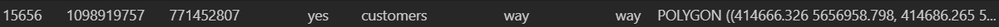

So smaller polygon has access=customers and big polygon has access=yes (means publicly accessible)

In [313]:
clean_joined_green_space[clean_joined_green_space['id_left']==1098919757].explore()

In [314]:
# clean_joined_green_space[(~clean_joined_green_space['access_left'].isna())&(~clean_joined_green_space['access_right'].isna())][['access_left', 'access_right', 'element_left', 'element_right', 'geometry']].explore()

**Note:** Some green spaces also contain the small area that has non-green/non-vegetation surface. But then again, if the area of small polygon is less than 100 sq.m., it is filtered out in te later step.

# Classify green spaces to be public/non-public

## 1. Use fee and charge tag to classify private area

In [315]:
clean_joined_green_space.loc[(clean_joined_green_space['fee_left'] == 'yes')|
                             (~clean_joined_green_space['charge_left'].isna()), 'is_public'] = 'no'

In [316]:
print("total green spaces that have fee or charge:", clean_joined_green_space[~clean_joined_green_space['is_public'].isna()].shape[0])

total green spaces that have fee or charge: 95


## 2. Use access tag to classify
- Access = yes/permissive -> public
- Access = no/private/customers/restricted -> private

In [317]:
clean_joined_green_space['access_left'].unique()

array([None, 'private', 'yes', 'customers', 'permissive', 'no', 'unknown',
       'permit', 'school'], dtype=object)

In [318]:
clean_joined_green_space.loc[((clean_joined_green_space['access_left'] == 'yes')|
                              (clean_joined_green_space['access_left'] == 'permissive')) & 
                              (clean_joined_green_space['is_public'].isna()), 'is_public'] = 'yes'

In [319]:
access_tag = clean_joined_green_space['access_left'].unique().tolist()
access_tag = [i for i in access_tag if (str(i) != 'nan')&(i is not None)]
private_tag = list(access_tag)
private_tag.remove('yes')
private_tag.remove('permissive')
private_tag

['private', 'customers', 'no', 'unknown', 'permit', 'school']

In [320]:
clean_joined_green_space.loc[clean_joined_green_space['access_left'].isin(private_tag)& 
                             clean_joined_green_space['is_public'].isna(), 'is_public'] = 'no'

In [321]:
print("total public green spaces:", clean_joined_green_space[clean_joined_green_space['is_public']=='yes'].shape[0])
print("total non-public green spaces:", clean_joined_green_space[clean_joined_green_space['is_public']=='no'].shape[0])

total public green spaces: 798
total non-public green spaces: 794


## 3. Use tag to classify non-public area
- tourism=zoo
- leisure=golf_course
- garden:type=residential/private
- landuse=vineyard

In [322]:
clean_joined_green_space['garden:type_left'].unique()

array([nan, None, 'botanical', 'community', 'residential', 'show_garden',
       'flowerbed', 'private', 'landscaping'], dtype=object)

In [323]:
clean_joined_green_space.loc[((clean_joined_green_space['tourism_left']=='zoo')|
                              (clean_joined_green_space['leisure_left']=='golf_course')|
                              (clean_joined_green_space['garden:type_left']=='residential')|
                              (clean_joined_green_space['garden:type_left']=='private')|
                              (clean_joined_green_space['landuse_left']=='vineyard'))&
                             (clean_joined_green_space['is_public'].isna()), 'is_public'] = 'no'

In [324]:
print("total public green spaces:", clean_joined_green_space[clean_joined_green_space['is_public']=='yes'].shape[0])
print("total non-public green spaces:", clean_joined_green_space[clean_joined_green_space['is_public']=='no'].shape[0])

total public green spaces: 798
total non-public green spaces: 1062


## 4. Use leisure=park tag to classify public area

In [325]:
clean_joined_green_space.loc[(clean_joined_green_space['leisure_left'] == 'park')&(clean_joined_green_space['is_public'].isna()), 'is_public'] = 'yes'

In [326]:
print("total public green spaces:", clean_joined_green_space[clean_joined_green_space['is_public']=='yes'].shape[0])
print("total non-public green spaces:", clean_joined_green_space[clean_joined_green_space['is_public']=='no'].shape[0])

total public green spaces: 2063
total non-public green spaces: 1062


## 5. Use another leisure and landuse tag to classify public/non-public

**Check landuse=forest**

percentage of forest area from total green spaces in Dresden -> check after remove duplicate

In terms of Dresden context, I think most of landuse=forest is public.

In [327]:
# clean_joined_green_space[clean_joined_green_space['landuse_left']=='forest'].explore()

In [328]:
# original df -> clean_all_green_space_gdf
clean_all_green_space_gdf['landuse'].unique()

array(['meadow', 'forest', 'allotments', 'grass', 'cemetery',
       'recreation_ground', 'vineyard', 'greenfield', 'orchard',
       'village_green', None, 'residential', 'construction', 'basin',
       'railway', 'brownfield'], dtype=object)

In [329]:
# total green spaces
total_green_area = clean_all_green_space_gdf['area'].sum()

In [330]:
# percentage of forest area
forest_area = clean_all_green_space_gdf['area'].groupby(clean_all_green_space_gdf['landuse']).sum()['forest']
forest_area_percentage = (forest_area/total_green_area)*100
print("percentage of forest area:", forest_area_percentage, "%")

percentage of forest area: 61.35632233439362 %


leisure=nature_reserve or landuse=cemetery -> public

Update: remove landuse=forest out

In [331]:
# clean_joined_green_space.loc[((clean_joined_green_space['leisure_left']=='nature_reserve')|
#                              (clean_joined_green_space['landuse_left']=='cemetery')|
#                              (clean_joined_green_space['landuse_left']=='forest'))&
#                              (clean_joined_green_space['is_public'].isna()), 'is_public'] = 'yes'

clean_joined_green_space.loc[((clean_joined_green_space['leisure_left']=='nature_reserve')|
                             (clean_joined_green_space['landuse_left']=='cemetery'))&
                             (clean_joined_green_space['is_public'].isna()), 'is_public'] = 'yes'

In [332]:
print("total public green spaces:", clean_joined_green_space[clean_joined_green_space['is_public']=='yes'].shape[0])
print("total non-public green spaces:", clean_joined_green_space[clean_joined_green_space['is_public']=='no'].shape[0])

total public green spaces: 2213
total non-public green spaces: 1062


landuse=allotments -> non-public (to be confirmed)

Need to confirm that **allotments** is public or private? (Maybe in case of Germany/Dresden first) -> allotments is only accessible by some group of people?

In [333]:
clean_joined_green_space.loc[(clean_joined_green_space['landuse_left']=='allotments')&
                             (clean_joined_green_space['is_public'].isna()), 'is_public'] = 'no'

In [334]:
print("total public green spaces:", clean_joined_green_space[clean_joined_green_space['is_public']=='yes'].shape[0])
print("total non-public green spaces:", clean_joined_green_space[clean_joined_green_space['is_public']=='no'].shape[0])

total public green spaces: 2213
total non-public green spaces: 2259


## 6. Use barrier tag to classify non-public area

In [335]:
print(clean_joined_green_space['barrier_left'].unique())
print('-'*20)
print(clean_joined_green_space['fence_type_left'].unique())


[None 'fence' 'wall' 'hedge']
--------------------
[nan None 'chain_link' 'wire' 'wood' 'metal']


In [336]:
clean_joined_green_space.loc[(~clean_joined_green_space['barrier_left'].isna())&(clean_joined_green_space['is_public'].isna()), 'is_public'] = 'no'

In [337]:
print("total public green spaces:", clean_joined_green_space[clean_joined_green_space['is_public']=='yes'].shape[0])
print("total non-public green spaces:", clean_joined_green_space[clean_joined_green_space['is_public']=='no'].shape[0])

total public green spaces: 2213
total non-public green spaces: 2378


**Note:** The **above number** includes the duplicate area since when we do spatial join, one area can contain multiple small areas and it results in some duplicated row

In [338]:
total_green_area = clean_joined_green_space['area_left'].sum()

In [339]:
print("total green spaces:", len(clean_joined_green_space['id_left'].unique()))
print("total labeled green spaces:", len(clean_joined_green_space[~clean_joined_green_space['is_public'].isna()]['id_left'].unique()))
print("total public green spaces:", len(clean_joined_green_space[clean_joined_green_space['is_public']=='yes']['id_left'].unique()))
print("total non-public green spaces:", len(clean_joined_green_space[clean_joined_green_space['is_public']=='no']['id_left'].unique()))
print("-"*20)
print("total green spaces (area):", total_green_area)
print("percentage of labeled green spaces (area):", (clean_joined_green_space[~clean_joined_green_space['is_public'].isna()]['area_left'].sum()/total_green_area)*100)
print("percentage of public green spaces (area):", (clean_joined_green_space[clean_joined_green_space['is_public']=='yes']['area_left'].sum()/total_green_area)*100)
print("percentage of non-public green spaces (area):", (clean_joined_green_space[clean_joined_green_space['is_public']=='no']['area_left'].sum()/total_green_area)*100)
print("Note: area still include duplicate polygon")

total green spaces: 21326
total labeled green spaces: 3478
total public green spaces: 1369
total non-public green spaces: 2109
--------------------
total green spaces (area): 5229385590.158771
percentage of labeled green spaces (area): 5.176248344339069
percentage of public green spaces (area): 4.035748446244455
percentage of non-public green spaces (area): 1.1404998980946153
Note: area still include duplicate polygon


# Explore after classify

### Green spaces that are already classified

check for the polygon that has small polygon inside

In [340]:
print("green space that is already classifies and contain small polygon:", 
      clean_joined_green_space[(clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])&
                               (~clean_joined_green_space['is_public'].isna())]['id_left'].unique().shape[0])

green space that is already classifies and contain small polygon: 299


In [341]:
clean_joined_green_space[(clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])&
                         (~clean_joined_green_space['is_public'].isna())].explore()

In [342]:
big_polygon_id = clean_joined_green_space[(clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])&
                                            (~clean_joined_green_space['is_public'].isna())]['id_left'].unique().tolist()
big_polygon_dict = {}

for i in big_polygon_id:
    temp = clean_joined_green_space[(clean_joined_green_space['id_left']==i)&
                                    (clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])]
    if i not in big_polygon_dict:
        big_polygon_dict[i] = {}
        if temp['is_public'].values[0] == 'yes':
            big_polygon_dict[i]['yes'] = 1
            big_polygon_dict[i]['no'] = 0
        elif temp['is_public'].values[0] == 'no':
            big_polygon_dict[i]['yes'] = 0
            big_polygon_dict[i]['no'] = 1
    print("small polygon that is contained in big polygon", i, "which is", temp['is_public'].values[0])
    print()
    for row in temp.itertuples():
        small_polygon_temp = clean_joined_green_space[(clean_joined_green_space['id_left']==row.id_right)&
                                                      (clean_joined_green_space['id_right']==row.id_right)].iloc[0]
        if (small_polygon_temp['is_public'] == 'yes')|(small_polygon_temp['is_public'] == 'no'):
            big_polygon_dict[i][small_polygon_temp['is_public']] += 1
            print("small polygon id:", small_polygon_temp['id_left'],small_polygon_temp['leisure_left'], 
                small_polygon_temp['landuse_left'], small_polygon_temp['garden:type_left'], 
                small_polygon_temp['tourism_left'], small_polygon_temp['access_left'],
                "is_public:", small_polygon_temp['is_public'])
        else:
            print("small polygon id:", small_polygon_temp['id_left'], "is unclassified")
    print('-'*20)

small polygon that is contained in big polygon 2181509 which is no

small polygon id: 163408209 None allotments nan None None is_public: no
small polygon id: 163408208 None allotments nan None None is_public: no
--------------------
small polygon that is contained in big polygon 3807857 which is no

small polygon id: 77487759 playground None None nan private is_public: no
small polygon id: 709615762 is unclassified
--------------------
small polygon that is contained in big polygon 3835288 which is yes

small polygon id: 28001532 is unclassified
small polygon id: 28001532 is unclassified
--------------------
small polygon that is contained in big polygon 10930127 which is no

small polygon id: 9023570908 is unclassified
--------------------
small polygon that is contained in big polygon 4232249 which is yes

small polygon id: 854646571 garden None community nan permissive is_public: yes
--------------------
small polygon that is contained in big polygon 11693827 which is no

small poly

small polygon id: 289488035 playground None None nan yes is_public: yes
small polygon id: 288252329 is unclassified
--------------------
small polygon that is contained in big polygon 28079891 which is no

small polygon id: 3724867245 is unclassified
small polygon id: 329102191 is unclassified
--------------------
small polygon that is contained in big polygon 28111049 which is no

small polygon id: 1097094183 pitch None None nan private is_public: no
--------------------
small polygon that is contained in big polygon 28774663 which is yes

small polygon id: 3204208792 is unclassified
--------------------
small polygon that is contained in big polygon 28934734 which is yes

small polygon id: 28005090 playground None None nan yes is_public: yes
small polygon id: 8354908246 is unclassified
small polygon id: 8354908247 is unclassified
--------------------
small polygon that is contained in big polygon 30214883 which is yes

small polygon id: 526813757 playground None None nan yes is_publi

In [343]:
# clean_joined_green_space[clean_joined_green_space['id_left']==684851608]

In [344]:
print("total number of big polygons:", len(big_polygon_dict))
print()
count = 0
conflict_id_list = []
for i in big_polygon_dict.keys():
    if (big_polygon_dict[i]['yes'] > 0) & (big_polygon_dict[i]['no'] > 0):
        count += 1
        conflict_id_list.append(i)
        temp = clean_joined_green_space[clean_joined_green_space['id_left']==i]
        print('polygon id:', i, 'is_public:', temp['is_public'].values[0], big_polygon_dict[i])
        print(temp['landuse_left'].values[0], temp['leisure_left'].values[0], temp['natural_left'].values[0], temp['tourism_left'].values[0])
        print('-'*20)
print()
print("polygons that have conflict of access:", count)

total number of big polygons: 299

polygon id: 23839504 is_public: no {'yes': 1, 'no': 1}
allotments None None None
--------------------
polygon id: 148538455 is_public: no {'yes': 1, 'no': 1}
allotments None None None
--------------------
polygon id: 431068944 is_public: yes {'yes': 1, 'no': 6}
grass park None None
--------------------
polygon id: 431069294 is_public: yes {'yes': 1, 'no': 2}
grass park None None
--------------------
polygon id: 365345 is_public: yes {'yes': 8, 'no': 4}
None park None nan
--------------------
polygon id: 5515462 is_public: yes {'yes': 1, 'no': 1}
None park None nan
--------------------
polygon id: 10699188 is_public: yes {'yes': 2, 'no': 1}
None park None nan
--------------------
polygon id: 4214985 is_public: yes {'yes': 2, 'no': 1}
None park None nan
--------------------
polygon id: 4214999 is_public: yes {'yes': 4, 'no': 1}
None park None nan
--------------------
polygon id: 4851355 is_public: yes {'yes': 1, 'no': 2}
None park None nan
-------------

In [345]:
# check area type of small polygons that has conflict of access with larger polygon
# code can be cleaner but it's okay for now
public_area = {}
non_public_area = {}
for i in big_polygon_dict.keys():
    temp = clean_joined_green_space[(clean_joined_green_space['id_left']==i)&(clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])]
    if (big_polygon_dict[i]['yes'] > 0) & (big_polygon_dict[i]['no'] > 0):
        if temp['is_public'].values[0] == 'yes':
            for row in temp.itertuples():
                temp_right = clean_joined_green_space[(clean_joined_green_space['id_left']==row.id_right)&(clean_joined_green_space['id_right']==row.id_right)]
                if (temp_right['is_public'].values[0]=='no')&(temp_right['element_left'].values[0]!='node')&(temp_right['area_left'].values[0]>100):
                    if row.leisure_right != None:
                        if row.leisure_right not in public_area:
                            public_area[row.leisure_right] = 1
                        else:
                            public_area[row.leisure_right] += 1
                    elif row.landuse_right != None:
                        if row.landuse_right not in public_area:
                            public_area[row.landuse_right] = 1
                        else:
                            public_area[row.landuse_right] += 1
                    elif row.tourism_right != None:
                        if row.tourism_right not in public_area:
                            public_area[row.tourism_right] = 1
                        else:
                            public_area[row.tourism_right] += 1
        elif temp['is_public'].values[0] == 'no':
            for row in temp.itertuples():
                temp_right = clean_joined_green_space[(clean_joined_green_space['id_left']==row.id_right)&(clean_joined_green_space['id_right']==row.id_right)]
                if (temp_right['is_public'].values[0]=='yes')&(temp_right['element_left'].values[0]!='node')&(temp_right['area_left'].values[0]>100):
                    if row.leisure_right != None:
                        if row.leisure_right not in non_public_area:
                            non_public_area[row.leisure_right] = 1
                        else:
                            non_public_area[row.leisure_right] += 1
                    elif row.landuse_right != None:
                        if row.landuse_right not in non_public_area:
                            non_public_area[row.landuse_right] = 1
                        else:
                            non_public_area[row.landuse_right] += 1
                    elif row.tourism_right != None:
                        if row.tourism_right not in non_public_area:
                            non_public_area[row.tourism_right] = 1
                        else:
                            non_public_area[row.tourism_right] += 1

In [346]:
print("small polygons inside public area:", public_area)
print("small polygons inside non-public area:", non_public_area)

small polygons inside public area: {'playground': 7, 'pitch': 2, 'vineyard': 2, nan: 1, 'allotments': 1}
small polygons inside non-public area: {'playground': 1, 'park': 8}


Conflict area viz

In [347]:
# clean_joined_green_space[clean_joined_green_space['id_left']== 205348079][['access_left', 'access_right', 'leisure_left', 'leisure_right', 'landuse_left', 'landuse_right', 'area_left', 'area_right', 'is_public']]
# clean_joined_green_space[clean_joined_green_space['id_left']== 431068944][['access_left', 'access_right', 'leisure_left', 'leisure_right', 'landuse_left', 'landuse_right', 'area_left', 'area_right', 'is_public']]

In [348]:
# clean_joined_green_space[clean_joined_green_space['id_left']== 431068944][['access_left', 'access_right', 'leisure_left', 'leisure_right', 'landuse_left', 'landuse_right', 'area_left', 'area_right', 'is_public', 'geometry']].explore()
# clean_joined_green_space[clean_joined_green_space['id_left']== 684851608][['access_left', 'access_right', 'leisure_left', 'leisure_right', 'area_left', 'area_right', 'is_public', 'geometry']].explore()

In [349]:
# clean_joined_green_space[clean_joined_green_space['id_left']==431068944][['access_left', 'access_right', 'leisure_left', 'surface_right', 'area_left', 'area_right', 'is_public']]

In [350]:
# clean_joined_green_space[clean_joined_green_space['id_left'].isin(conflict_id_list)].explore()

**Note:**

What to do with this case? -> so just overlay the private area?

In [351]:
# clean_joined_green_space[clean_joined_green_space['id_left']==10699188][['element_left', 'element_right', 
#                                                                          'id_left', 'id_right',
#                                                                          'leisure_left', 'leisure_right',
#                                                                          'surface_left', 'surface_right',
#                                                                          'access_left', 'access_right',
#                                                                          'area_left', 'area_right',
#                                                                          'is_public']]

In [352]:
# clean_joined_green_space[clean_joined_green_space['id_left']==10699188][['is_public', 'geometry']].explore()

In [353]:
# clean_joined_green_space[(clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])&(clean_joined_green_space['is_public'].isna())][['id_left', 'id_right', 'element_left', 'element_right', 'is_public', 'access_left', 'access_right', 'geometry']].explore()

### Green spaces that are unclassified

In [354]:
# clean_joined_green_space[(clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])&
#                          (clean_joined_green_space['is_public'].isna())&
#                          (~clean_joined_green_space['access_right'].isna())][['element_left', 'element_right', 
#                                                                             'id_left', 'id_right',
#                                                                             'leisure_left', 'leisure_right',
#                                                                             'surface_left', 'surface_right',
#                                                                             'access_left', 'access_right',
#                                                                             'is_public']]

In [355]:
# clean_joined_green_space[(clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])&
#                          (clean_joined_green_space['is_public'].isna())&
#                          (~clean_joined_green_space['access_right'].isna())][['element_left', 'element_right', 
#                                                                             'id_left', 'id_right',
#                                                                             'leisure_left', 'leisure_right',
#                                                                             'surface_left', 'surface_right',
#                                                                             'access_left', 'access_right',
#                                                                             'is_public', 'geometry']].explore()

In [356]:
unlabel_green_space = clean_joined_green_space[clean_joined_green_space['is_public'].isna()]

In [357]:
print("total unlabeled green spaces:", unlabel_green_space['id_right'].unique().shape[0])
print("total unlabeled green spaces that contain node:", unlabel_green_space[(unlabel_green_space['element_right']=='node')&
                                                                             (unlabel_green_space['id_left']!=unlabel_green_space['id_right'])]
                                                                             ['id_right'].unique().shape[0])

total unlabeled green spaces: 18042
total unlabeled green spaces that contain node: 243


In [358]:
# unlabel_green_space.explore()

In [359]:
print(unlabel_green_space[(unlabel_green_space['element_right']=='node')&(unlabel_green_space['id_left']!=unlabel_green_space['id_right'])]['leisure_right'].unique())
print(unlabel_green_space[(unlabel_green_space['element_right']=='node')&(unlabel_green_space['id_left']!=unlabel_green_space['id_right'])]['access_right'].unique())

[None 'pitch' 'playground' 'picnic_table' 'garden']
[None 'yes' 'customers' 'private' 'no' 'permissive' 'unknown']


In [360]:
clean_joined_green_space[(clean_joined_green_space['landuse_left']=='forest')&(~clean_joined_green_space['barrier_left'].isna())]

,element_left,id_left,landuse_left,name_left,barrier_left,note_left,opening_hours_left,access_left,description_left,leisure_left,...,natural_right,type_right,area_right,operator_right,playground_right,fee_right,charge_right,fence_type_right,garden:type_right,is_public
1015,way,27203224,forest,Wildgehege Albertpark,fence,None,"""nicht gestattet/ selten nach individueller Ve...",None,None,None,...,None,None,26701.181844,NaN,NaN,NaN,NaN,NaN,NaN,no
1015,way,27203224,forest,Wildgehege Albertpark,fence,None,"""nicht gestattet/ selten nach individueller Ve...",None,None,None,...,None,NaN,26701.181844,"Landeshauptstadt Dresden, Amt f. Stadtgrün u. ...",NaN,None,None,None,NaN,no
4524,way,337028905,forest,None,wall,None,None,None,None,None,...,None,None,2269.957552,NaN,NaN,NaN,NaN,NaN,NaN,no
5951,way,453037244,forest,None,fence,None,None,None,None,None,...,None,None,23194.415725,NaN,NaN,NaN,NaN,NaN,NaN,no
21355,way,27203224,forest,Wildgehege Albertpark,fence,None,"""nicht gestattet/ selten nach individueller Ve...",None,None,None,...,None,None,26701.181844,NaN,NaN,NaN,NaN,NaN,NaN,no
21355,way,27203224,forest,Wildgehege Albertpark,fence,None,"""nicht gestattet/ selten nach individueller Ve...",None,None,None,...,None,NaN,26701.181844,"Landeshauptstadt Dresden, Amt f. Stadtgrün u. ...",NaN,None,None,None,NaN,no


In [361]:
# clean_joined_green_space[(clean_joined_green_space['is_public'].isna())&
#                          (clean_joined_green_space['element_left']!='node')].explore()

In [362]:
# clean_joined_green_space[(~clean_joined_green_space['is_public'].isna())&
#                          (clean_joined_green_space['element_left']!='node')].explore()

In [363]:
# polygon that surface isn't grass if it is indicated
print(unlabel_green_space['surface_left'].unique())

[None 'grass' 'gravel' 'concrete' 'dirt' 'sand' 'tartan' 'clay'
 'artificial_turf' 'asphalt' 'ground' 'fine_gravel' 'compacted' 'rubber'
 'paving_stones' 'sett' 'wood' 'unpaved' 'pebblestone' 'woodchips'
 'dirt/sand' 'acrylic' 'textile_chips' nan 'stone']


In [364]:
unlabel_green_space[(unlabel_green_space['element_right']=='node')&
                    (unlabel_green_space['id_left']!=unlabel_green_space['id_right'])].shape[0]

248

In [365]:
unlabel_green_space[(unlabel_green_space['element_right']=='node')&
                    (unlabel_green_space['id_left']!=unlabel_green_space['id_right'])&
                    (unlabel_green_space['surface_right']=='grass')].shape[0]

3

In [366]:
# unlabel_green_space[(unlabel_green_space['element_right']=='node')&(unlabel_green_space['id_left']!=unlabel_green_space['id_right'])].explore()

Assigned the value to unclassified polygon based on small polygons/nodes inside them

In [367]:
# clean_joined_green_space[clean_joined_green_space['leisure_left']=='pitch']['surface_left'].unique()

In [368]:
# clean_joined_green_space[(clean_joined_green_space['leisure_left']=='pitch')&(clean_joined_green_space['surface_left']=='grass')].explore()

To classify the accessibility of green spaces (larger polygon), I use the area of small polygon inside them to classify.
- If total public area inside polygon are more than non-public, that polygon is classifies as public
- If total non-public area inside polygon are more than public, that polygon is classifies as non-public

**Note:** Some polygon might also contain the node (playground, pitch, garden, etc.). I also assign the area for the node to make it be able to aggregate with small polygon's area. So, below code is or finding the average percentage of playground, pitch, garden, etc. in the green space based on the classified green spaces data.

In [369]:
leisure_node_element_list = clean_joined_green_space[(clean_joined_green_space['element_right']=='node')&
                                                                          (clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])]['leisure_right'].unique().tolist()
landuse_node_element_list = clean_joined_green_space[(clean_joined_green_space['element_right']=='node')&
                                                                          (clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])]['landuse_right'].unique().tolist()
print("leisure tag of node element in polygon:", leisure_node_element_list)
print("landuse tag of node element in polygon:", landuse_node_element_list)

leisure tag of node element in polygon: [None, 'pitch', 'playground', 'picnic_table', 'garden']
landuse tag of node element in polygon: [None, 'meadow', 'forest']


In [370]:
test_area = clean_joined_green_space[((clean_joined_green_space['element_right']=='way')|(clean_joined_green_space['element_right']=='relation'))&
                                     (clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])]

In [371]:
pc_area_dict = {}
for row in test_area.itertuples():
    if (row.leisure_right != None) & (row.leisure_right in leisure_node_element_list):
        pc_area = (row.area_right/row.area_left)*100
        if row.leisure_right not in pc_area_dict:
            pc_area_dict[row.leisure_right] = []
            pc_area_dict[row.leisure_right].append(pc_area)
        else:
            pc_area_dict[row.leisure_right].append(pc_area)
    if (row.landuse_right != None)&(row.landuse_right in landuse_node_element_list):
        pc_area = (row.area_right/row.area_left)*100
        if row.landuse_right not in pc_area_dict:
            pc_area_dict[row.landuse_right] = []
            pc_area_dict[row.landuse_right].append(pc_area)
        else:
            pc_area_dict[row.landuse_right].append(pc_area)

In [372]:
pc_avg_area = {k : round(np.mean(v)) for k, v in pc_area_dict.items()}

In [373]:
pc_avg_area

{'forest': 7, 'playground': 6, 'pitch': 6, 'meadow': 6, 'garden': 2}

In [374]:
# Need to check the access tag of the small polygon -> so get unique big polygon first
# Then, get access of small polygon
# unlabel_green_space = clean_joined_green_space[clean_joined_green_space['is_public'].isna()]
big_polygon_id = unlabel_green_space['id_left'].unique().tolist()

for i in big_polygon_id:
    small_polygon_id = clean_joined_green_space[(clean_joined_green_space['id_left']==i)&(clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])]['id_right'].unique().tolist()
    pub_area = 0
    nonpub_area = 0
    temp_area_list = []
    count = 0
    small_polygon_total_area = 0
    total_area = clean_joined_green_space[clean_joined_green_space['id_left']==i]['area_left'].values[0]
    for j in small_polygon_id:
        # check 'is_public' column of small polygon and save its area
        # all 'is_public' column of small polygon shouldn't be NA
        # For node, I assume that it has 5% of total area so it can be aggregated with polygon
        temp = clean_joined_green_space[clean_joined_green_space['id_left']==j]
        if temp['is_public'].values[0]=='yes':
            if temp['element_left'].values[0]=='node':
                if temp['leisure_left'].values[0] != None:
                    pc = pc_avg_area[temp['leisure_left'].values[0]]
                    pub_area += (pc*total_area)/100
                elif temp['landuse_left'].values[0] != None:
                    pc = pc_avg_area[temp['landuse_left'].values[0]]
                    pub_area += (pc*total_area)/100
            else:
                pub_area += temp['area_left'].values[0]
        elif temp['is_public'].values[0]=='no':
            if temp['element_left'].values[0]=='node':
                if temp['leisure_left'].values[0] != None:
                    pc = pc_avg_area[temp['leisure_right'].values[0]]
                    nonpub_area += (pc*total_area)/100
                elif temp['landuse_left'].values[0] != None:
                    pc = pc_avg_area[temp['landuse_left'].values[0]]
                    nonpub_area += (pc*total_area)/100
            else:
                nonpub_area += temp['area_left'].values[0]
        # count += 1
    # check if there is green space that contain both public and non-public area (not include node)
    # if (count == len(small_polygon_id))&(count != 0)&(pub_area != 0)&(nonpub_area != 0):
    #     print(i, pub_area, nonpub_area)
    # assigned based on the area
    # -----------------------------
    # after applying threshold, only 1 area is classified since some small polygon inside is unclassified.
    if (pub_area > nonpub_area) & (pub_area>((60*total_area)/100)):
        # print('yes')
        clean_joined_green_space.loc[(clean_joined_green_space['id_left']==i)&(clean_joined_green_space['id_right'].isin(small_polygon_id)),'is_public'] = 'yes'
    elif (pub_area < nonpub_area) & (nonpub_area>((60*total_area)/100)):
        # print('no')
        clean_joined_green_space.loc[(clean_joined_green_space['id_left']==i)&(clean_joined_green_space['id_right'].isin(small_polygon_id)),'is_public'] = 'no'
    # -----------------------------
    # if pub_area > nonpub_area:
    #     # print('yes')
    #     clean_joined_green_space.loc[(clean_joined_green_space['id_left']==i)&(clean_joined_green_space['id_right'].isin(small_polygon_id)),'is_public'] = 'yes'
    # elif pub_area < nonpub_area:
    #     # print('no')
    #     clean_joined_green_space.loc[(clean_joined_green_space['id_left']==i)&(clean_joined_green_space['id_right'].isin(small_polygon_id)),'is_public'] = 'no'

# clean_joined_green_space[(clean_joined_green_space['id_left']!=clean_joined_green_space['id_right'])&
#                          (clean_joined_green_space['is_public'].isna())]

In [375]:
total_green_area = clean_joined_green_space['area_left'].sum()

In [376]:
print("total green spaces:", len(clean_joined_green_space['id_left'].unique()))
print("total labeled green spaces:", len(clean_joined_green_space[~clean_joined_green_space['is_public'].isna()]['id_left'].unique()))
print("total public green spaces:", len(clean_joined_green_space[clean_joined_green_space['is_public']=='yes']['id_left'].unique()))
print("total non-public green spaces:", len(clean_joined_green_space[clean_joined_green_space['is_public']=='no']['id_left'].unique()))
print("-"*20)
print("total green spaces (area):", total_green_area)
print("percentage of labeled green spaces (area):", (clean_joined_green_space[~clean_joined_green_space['is_public'].isna()]['area_left'].sum()/total_green_area)*100)
print("percentage of public green spaces (area):", (clean_joined_green_space[clean_joined_green_space['is_public']=='yes']['area_left'].sum()/total_green_area)*100)
print("percentage of non-public green spaces (area):", (clean_joined_green_space[clean_joined_green_space['is_public']=='no']['area_left'].sum()/total_green_area)*100)
print("Note: area still include duplicate polygon")

total green spaces: 21326
total labeled green spaces: 3479
total public green spaces: 1369
total non-public green spaces: 2110
--------------------
total green spaces (area): 5229385590.158771
percentage of labeled green spaces (area): 5.176299092638492
percentage of public green spaces (area): 4.035748446244455
percentage of non-public green spaces (area): 1.1405506463940378
Note: area still include duplicate polygon


# Clean data for next steps (ML)

Need to decide whether ML is needed or not

## Filter area that is < 100 m2 out

In [377]:
final_clean_joined_green_space = clean_joined_green_space[clean_joined_green_space['area_left'] > 100]

In [378]:
print("total green spaces:", len(final_clean_joined_green_space['id_left'].unique()))
print("total labeled green spaces:", len(final_clean_joined_green_space[~final_clean_joined_green_space['is_public'].isna()]['id_left'].unique()))
print("total public green spaces:", len(final_clean_joined_green_space[final_clean_joined_green_space['is_public']=='yes']['id_left'].unique()))
print("total non-public green spaces:", len(final_clean_joined_green_space[final_clean_joined_green_space['is_public']=='no']['id_left'].unique()))

total green spaces: 17566
total labeled green spaces: 2831
total public green spaces: 1041
total non-public green spaces: 1790


## Remove indoor space out

In [379]:
final_clean_joined_green_space.columns

Index(['element_left', 'id_left', 'landuse_left', 'name_left', 'barrier_left',
       'note_left', 'opening_hours_left', 'access_left', 'description_left',
       'leisure_left', 'tourism_left', 'surface_left', 'landcover_left',
       'indoor_left', 'natural_left', 'type_left', 'geometry', 'area_left',
       'operator_left', 'playground_left', 'fee_left', 'charge_left',
       'fence_type_left', 'garden:type_left', 'index_right', 'element_right',
       'id_right', 'landuse_right', 'name_right', 'barrier_right',
       'note_right', 'opening_hours_right', 'access_right',
       'description_right', 'leisure_right', 'tourism_right', 'surface_right',
       'landcover_right', 'indoor_right', 'natural_right', 'type_right',
       'area_right', 'operator_right', 'playground_right', 'fee_right',
       'charge_right', 'fence_type_right', 'garden:type_right', 'is_public'],
      dtype='object')

In [380]:
print("indoor tag:", final_clean_joined_green_space['indoor_left'].unique())
print("indoor tag (polygon/node inside bigger pollygon):", final_clean_joined_green_space['indoor_right'].unique())

indoor tag: [nan None]
indoor tag (polygon/node inside bigger pollygon): [nan None 'yes' 'no']


In [381]:
final_clean_joined_green_space = final_clean_joined_green_space[final_clean_joined_green_space['indoor_left']!='yes']

## Remove polygon that is not green space/surface isn't grass out (if surface value is specified) and keep it in another df

Note: We will keep it if it inside the green space polygon

In [382]:
small_polygon_id = final_clean_joined_green_space[final_clean_joined_green_space['id_left']!=final_clean_joined_green_space['id_right']]['id_right'].unique().tolist()
all_polygon_id = final_clean_joined_green_space['id_left'].unique()

In [383]:
non_green_surface = final_clean_joined_green_space[(final_clean_joined_green_space['id_left'].isin(small_polygon_id))&
                                                   (((final_clean_joined_green_space['surface_left']!='grass')&
                                                   (~final_clean_joined_green_space['surface_left'].isna()))|
                                                   (final_clean_joined_green_space['leisure_left']=='water_park')|
                                                   (final_clean_joined_green_space['natural_left']=='water'))]

In [384]:
# non_green_surface = final_clean_joined_green_space[(final_clean_joined_green_space['surface_left']!='grass')&(~final_clean_joined_green_space['surface_left'].isna())]

In [385]:
non_green_surface = non_green_surface.drop_duplicates(subset=['id_left'])

In [386]:
print("total non-green areas:", non_green_surface.shape[0])

total non-green areas: 115


In [387]:
non_green_surface[non_green_surface['area_left'].isna()]

,element_left,id_left,landuse_left,name_left,barrier_left,note_left,opening_hours_left,access_left,description_left,leisure_left,...,natural_right,type_right,area_right,operator_right,playground_right,fee_right,charge_right,fence_type_right,garden:type_right,is_public


In [388]:
print("average area of small polygon that is non-green surface:", non_green_surface['area_left'].mean())

average area of small polygon that is non-green surface: 712.5293632699319


In [389]:
non_green_surface[['area_left', 'geometry', 'surface_left']].explore()

In [390]:
final_clean_joined_green_space = final_clean_joined_green_space[~(((final_clean_joined_green_space['surface_left']!='grass')&
                                                                   (~final_clean_joined_green_space['surface_left'].isna()))|
                                                                   (final_clean_joined_green_space['leisure_left']=='water_park')|
                                                                   (final_clean_joined_green_space['natural_left']=='water'))]

In [391]:
total_green_area = final_clean_joined_green_space['area_left'].sum()

In [392]:
print("total green spaces:", len(final_clean_joined_green_space['id_left'].unique()))
print("total labeled green spaces:", len(final_clean_joined_green_space[~final_clean_joined_green_space['is_public'].isna()]['id_left'].unique()))
print("total public green spaces:", len(final_clean_joined_green_space[final_clean_joined_green_space['is_public']=='yes']['id_left'].unique()))
print("total non-public green spaces:", len(final_clean_joined_green_space[final_clean_joined_green_space['is_public']=='no']['id_left'].unique()))
print("-"*20)
print("total green spaces (area):", total_green_area)
print("percentage of labeled green spaces (area):", (final_clean_joined_green_space[~final_clean_joined_green_space['is_public'].isna()]['area_left'].sum()/total_green_area)*100)
print("percentage of public green spaces (area):", (final_clean_joined_green_space[final_clean_joined_green_space['is_public']=='yes']['area_left'].sum()/total_green_area)*100)
print("percentage of non-public green spaces (area):", (final_clean_joined_green_space[final_clean_joined_green_space['is_public']=='no']['area_left'].sum()/total_green_area)*100)
print("Note: area still include duplicate polygon")

total green spaces: 17076
total labeled green spaces: 2722
total public green spaces: 1006
total non-public green spaces: 1716
--------------------
total green spaces (area): 5227779835.567524
percentage of labeled green spaces (area): 5.17175298550905
percentage of public green spaces (area): 4.036548552171192
percentage of non-public green spaces (area): 1.1352044333378584
Note: area still include duplicate polygon


In [393]:
import matplotlib.colors as mcolors

# Create custom color map
colors = mcolors.ListedColormap(['#ff4d4d', '#4dff4d'])  # Red for private, Green for public
# final_clean_joined_green_space[~final_clean_joined_green_space['is_public'].isna()].explore(column='is_public', categorical=True, cmap=colors,legend=True)

In [394]:
# final_clean_joined_green_space[final_clean_joined_green_space['is_public'].isna()].explore()

In [395]:
# final_clean_joined_green_space[(final_clean_joined_green_space['surface_left']!='grass')&(~final_clean_joined_green_space['surface_left'].isna())].explore()

In [396]:
# final_clean_joined_green_space[final_clean_joined_green_space['id_left']==332065461].explore()

# Dissolve polygon (if small polygon and large polygon have same access) and if public is in private area

In [397]:
polygon_id_remove_list = []
small_polygon_list = []

small_polygon_list = final_clean_joined_green_space[final_clean_joined_green_space['id_left']!=final_clean_joined_green_space['id_right']]['id_right'].unique().tolist()

large_polygon_gdf = final_clean_joined_green_space[(~final_clean_joined_green_space['is_public'].isna())&
                                                   (final_clean_joined_green_space['id_left']!=final_clean_joined_green_space['id_right'])&
                                                   (~final_clean_joined_green_space['id_left'].isin(small_polygon_list))]

for row in large_polygon_gdf.itertuples():
    temp = final_clean_joined_green_space[(final_clean_joined_green_space['id_left']==row.id_right)&(final_clean_joined_green_space['id_right']==row.id_right)]
    if temp.shape[0] > 0:
        if temp['is_public'].values[0]==row.is_public:
            polygon_id_remove_list.append(row.id_right)

In [398]:
polygon_id_remove_list = list(set(polygon_id_remove_list)) # remove duplicate id

In [399]:
print("total polygon that will be removed:", len(polygon_id_remove_list))

total polygon that will be removed: 93


In [400]:
final_clean_joined_green_space[final_clean_joined_green_space['id_left'].isin(polygon_id_remove_list)].explore()

In [401]:
final_clean_joined_green_space = final_clean_joined_green_space[~final_clean_joined_green_space['id_left'].isin(polygon_id_remove_list)]

# Overlay

In [402]:
test_final_df = final_clean_joined_green_space.drop_duplicates(subset=['id_left'])

In [403]:
# test = gpd.overlay(test_final_df, test_final_df, how='difference')

In [404]:
test = gpd.overlay(test_final_df, non_green_surface, how='difference')
# test = gpd.overlay(test, non_green_surface, how='difference')

In [405]:
test['id_left'].shape[0]

16983

In [406]:
test[test['id_left']==10699188]

,element_left,id_left,landuse_left,name_left,barrier_left,note_left,opening_hours_left,access_left,description_left,leisure_left,...,natural_right,type_right,area_right,operator_right,playground_right,fee_right,charge_right,fence_type_right,garden:type_right,is_public
10741,relation,10699188,None,None,None,None,None,None,None,park,...,None,None,107.377629,NaN,NaN,NaN,NaN,NaN,NaN,yes


In [407]:
print("(final) total green spaces:", test['id_left'].shape[0])
print("(final) total labeled green spaces:", test[~test['is_public'].isna()].shape[0])
print("(final) total public green spaces:", test[test['is_public']=='yes'].shape[0])
print("(final) total non-public green spaces:", test[test['is_public']=='no'].shape[0])
print("-"*20)
print("(final) total green spaces (area):", test['area_left'].sum())
print("(final) percentage of labeled green spaces (area):", (test[~test['is_public'].isna()]['area_left'].sum()/test['area_left'].sum())*100)
print("(final) percentage of public green spaces (area):", (test[test['is_public']=='yes']['area_left'].sum()/test['area_left'].sum())*100)
print("(final) percentage of non-public green spaces (area):", (test[test['is_public']=='no']['area_left'].sum()/test['area_left'].sum())*100)

(final) total green spaces: 16983
(final) total labeled green spaces: 2629
(final) total public green spaces: 934
(final) total non-public green spaces: 1695
--------------------
(final) total green spaces (area): 383230814.16132003
(final) percentage of labeled green spaces (area): 10.82240814728509
(final) percentage of public green spaces (area): 5.577478081881748
(final) percentage of non-public green spaces (area): 5.24493006540334


In [408]:
print("average area of unclassified green spaces:", test[test['is_public'].isna()]['area_left'].mean())

average area of unclassified green spaces: 23809.11323022282


In [409]:
test[~test['is_public'].isna()].explore(column='is_public', categorical=True, cmap=colors, legend=True)

In [410]:
# test[test['name_left']=='Friedewald'][['id_left', 'is_public', 'geometry']].explore()

In [411]:
# test.explore(column='is_public', categorical=True, cmap=colors,legend=True)

# Calculate additional information to classify public/private area

1. footpath length
2. presence/number of bench and playground
3. proximity to road?

Calculate for the classify one as well -> Train RF -> Use trained RF to predict on unclassified area?

## Calculate the number of bench, playground, picnic table, and waste basket for each polygon

In [412]:
green_space_rf = test[['id_left', 'name_left', 'geometry', 'area_left', 'landcover_left', 'landuse_left', 'is_public']]

In [413]:
# poi_amenity_greenspace = poi_amenity.sjoin(nodup_green_space, how='inner', predicate='within')
# poi_leisure_greenspace = poi_leisure.sjoin(nodup_green_space, how='inner', predicate='within')
poi_amenity_greenspace = poi_amenity.sjoin(green_space_rf, how='inner', predicate='within')
poi_leisure_greenspace = poi_leisure.sjoin(green_space_rf, how='inner', predicate='within')

In [414]:
print(poi_amenity_greenspace.shape[0], poi_leisure_greenspace.shape[0])

6531 1059


In [415]:
group_poi_amenity = poi_amenity_greenspace.groupby(by=['id_left', 'amenity']).size().reset_index(name='count')
group_poi_leisure = poi_leisure_greenspace.groupby(by=['id_left', 'leisure']).size().reset_index(name='count')

In [416]:
group_poi_amenity = pd.pivot_table(group_poi_amenity, values='count', index='id_left', columns='amenity', fill_value=0)
group_poi_leisure = pd.pivot_table(group_poi_leisure, values='count', index='id_left', columns='leisure', fill_value=0)

In [417]:
green_space_rf = green_space_rf.merge(group_poi_amenity, how='left', left_on='id_left', right_on='id_left')

In [418]:
green_space_rf = green_space_rf.merge(group_poi_leisure, how='left', left_on='id_left', right_on='id_left')

In [419]:
green_space_rf.columns

Index(['id_left', 'name_left', 'geometry', 'area_left', 'landcover_left',
       'landuse_left', 'is_public', 'bench', 'waste_basket', 'picnic_table',
       'playground'],
      dtype='object')

In [420]:
green_space_rf[['bench', 'waste_basket', 'picnic_table', 'playground']] = green_space_rf[['bench', 'waste_basket', 'picnic_table', 'playground']].fillna(0)

In [421]:
# green_space_rf.head()

## Calculate footpath length in each polygon

In [422]:
# footpath_network_edges.head()

In [423]:
footpath_network_edges = footpath_network_edges.to_crs(epsg=32633)

In [424]:
footpath_green_space = green_space_rf.sjoin(footpath_network_edges, how='left', predicate='intersects')

In [425]:
footpath_length_sum = footpath_green_space.groupby(by='id_left')['length'].sum().reset_index()

In [426]:
footpath_length_sum = footpath_length_sum.rename(columns={'length':'footpath_length'})

In [427]:
green_space_rf = green_space_rf.merge(footpath_length_sum, how='inner', left_on='id_left', right_on='id_left')

In [428]:
# green_space_rf.head()

## Calculate cycle path length

In [429]:
# cycle_network_edges.head()

In [430]:
cycle_network_edges = cycle_network_edges.to_crs(epsg=32633)

In [431]:
cycle_green_space = green_space_rf.sjoin(cycle_network_edges, how='left', predicate='intersects')

In [432]:
cycle_length_sum = cycle_green_space.groupby(by='id_left')['length'].sum().reset_index()

In [433]:
cycle_length_sum = cycle_length_sum.rename(columns={'length':'cycle_length'})

In [434]:
green_space_rf = green_space_rf.merge(cycle_length_sum, how='inner', left_on='id_left', right_on='id_left')

In [435]:
# green_space_rf.head()

## Calculate min distance from street

In [436]:
road_network_edges = road_network_edges.to_crs(epsg=32633)

In [437]:
from shapely.ops import nearest_points
from rtree import index

# Create an R-tree index for roads
roads_index = index.Index()
for idx, road in road_network_edges.geometry.items():
    roads_index.insert(idx, road.bounds)

# Function to find the nearest road using R-tree
def find_nearest_road(green_space, roads_gdf, roads_index):
    # Find the nearest road using R-tree
    nearest_idx = list(roads_index.nearest(green_space.bounds, num_results=1))
    nearest_road = roads_gdf.iloc[nearest_idx].geometry.values[0]
    
    # Calculate the distance
    distance = green_space.distance(nearest_road)
    return distance

# Apply the function to each green space
green_space_rf['min_distance_to_road'] = green_space_rf.geometry.apply(
    lambda x: find_nearest_road(x, road_network_edges, roads_index)
)

In [438]:
# green_space_rf.head()

In [439]:
green_space_rf[~green_space_rf['is_public'].isna()].groupby(by='is_public')[['bench', 'waste_basket', 'playground', 'picnic_table', 'area_left', 'min_distance_to_road', 'footpath_length', 'cycle_length']].mean()

,bench,waste_basket,playground,picnic_table,area_left,min_distance_to_road,footpath_length,cycle_length
is_public,,,,,,,,
no,0.194690,0.041298,0.092035,0.004720,11858.518107,90.520072,434.729377,255.605794
yes,3.092077,0.912206,0.449679,0.040685,22885.026406,83.343504,971.713752,453.705358


## Calculate the number of viewpoints for each polygon

In [440]:
poi_viewpoint = gpd.read_file('../data/raw/osm/amenity/poi_viewpoint_dresden.geojson')

In [441]:
poi_viewpoint = poi_viewpoint.to_crs(epsg=32633)

In [442]:
poi_viewpoint.head()

,element,id,highway,toilets:wheelchair,tourism,wheelchair,name,name:de,noexit,description,...,source,tower:construction,charge,comment,old_name,loc_name,subject:wikipedia,building:levels,name:en,geometry
0,node,67366424,turning_circle,yes,viewpoint,yes,None,None,None,None,...,None,None,None,None,None,None,None,None,None,POINT (403904.735 5663529.148)
1,node,71744963,None,None,viewpoint,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,POINT (406659.489 5667933.973)
2,node,248567811,None,None,viewpoint,no,Am Zwingergraben,Am Zwingergraben,yes,None,...,None,None,None,None,None,None,None,None,None,POINT (411130.285 5656571.446)
3,node,248966496,None,None,viewpoint,limited,Turm Kreuzkirche,Turm Kreuzkirche,None,Aufstieg über Eingang F der Kreuzkirche,...,None,None,None,None,None,None,None,None,None,POINT (411603.505 5656002.758)
4,node,251043383,None,None,viewpoint,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,POINT (409649.619 5653164.474)


In [443]:
poi_viewpoint.explore()

In [444]:
poi_viewpoint_greenspace = poi_viewpoint.sjoin(green_space_rf, how='inner', predicate='within')

In [445]:
group_poi_viewpoint = poi_viewpoint_greenspace.groupby(by='id_left').size().reset_index(name='count')


In [446]:
group_poi_viewpoint = group_poi_viewpoint.rename(columns={'count':'viewpoint'})

In [447]:
green_space_rf = green_space_rf.merge(group_poi_viewpoint, how='left', left_on='id_left', right_on='id_left')

In [448]:
green_space_rf['viewpoint'] = green_space_rf['viewpoint'].fillna(0)

# Classify green spaces based on additional indicators???

**Note:** Having the amenity doesn't always mean that the area is public, right?

In [449]:
green_space_rf.head()

,id_left,name_left,geometry,area_left,landcover_left,landuse_left,is_public,bench,waste_basket,picnic_table,playground,footpath_length,cycle_length,min_distance_to_road,viewpoint
0,6128,Dresdner Heide,"MULTIPOLYGON (((422682.225 5662327.517, 422778...",5.293124e+07,None,forest,NaN,140.0,3.0,12.0,6.0,1.269088e+06,1.257452e+06,1235.474145,3.0
1,22720,Tharandter Wald,"MULTIPOLYGON (((391086.484 5644235.349, 391133...",5.613852e+07,None,forest,NaN,7.0,0.0,0.0,0.0,1.963960e+04,1.339152e+04,335.591167,0.0
2,51861,None,"POLYGON ((422507.812 5648579.133, 422497.737 5...",3.736947e+04,None,meadow,NaN,0.0,0.0,0.0,0.0,0.000000e+00,0.000000e+00,2.936336,0.0
3,75554,None,"POLYGON ((409573.212 5668571.839, 409573.479 5...",7.028653e+05,None,meadow,NaN,0.0,0.0,0.0,0.0,9.316010e+03,9.311721e+03,1.895002,0.0
4,78743,None,"POLYGON ((406468.749 5668564.649, 406500.436 5...",5.486299e+05,None,meadow,NaN,2.0,0.0,0.0,0.0,1.542919e+04,1.542919e+04,66.194618,1.0


In [450]:
print("Number of unclassified green spaces that has amenity (bench, waste basket, playground) inside")
print("Number of green spaces that has bench:", green_space_rf[(green_space_rf['bench']>0)&(green_space_rf['is_public'].isna())].shape[0])
print("Number of green spaces that has waste basket:", green_space_rf[(green_space_rf['waste_basket']>0)&(green_space_rf['is_public'].isna())].shape[0])
print("Number of green spaces that has playground:", green_space_rf[(green_space_rf['playground']>0)&(green_space_rf['is_public'].isna())].shape[0])
print()
print("Number of green spaces that has all amenities inside:", green_space_rf[(green_space_rf['bench']>0)&
                                                                              (green_space_rf['waste_basket']>0)&
                                                                              (green_space_rf['playground']>0)&
                                                                              (green_space_rf['is_public'].isna())].shape[0])

Number of unclassified green spaces that has amenity (bench, waste basket, playground) inside
Number of green spaces that has bench: 634
Number of green spaces that has waste basket: 201
Number of green spaces that has playground: 347

Number of green spaces that has all amenities inside: 38


In [451]:
print("landuse:", green_space_rf['landuse_left'].unique())
print()
print("land cover:", green_space_rf['landcover_left'].unique())

landuse: ['forest' 'meadow' 'allotments' 'grass' 'cemetery' 'recreation_ground'
 'vineyard' 'greenfield' 'orchard' 'village_green' None 'residential'
 'construction' 'basin' 'railway' 'brownfield']

land cover: [None 'trees' 'grass' 'bushes' 'scrub' nan]


In [452]:
green_space_rf[(green_space_rf['bench']>0)&
                (green_space_rf['waste_basket']>0)&
                (green_space_rf['playground']>0)&
                (green_space_rf['is_public'].isna())]['landuse_left'].unique()

array(['forest', 'recreation_ground', 'grass', 'village_green', 'meadow',
       None], dtype=object)

In [453]:
green_space_rf[(green_space_rf['bench']>0)&
                (green_space_rf['waste_basket']>0)&
                (green_space_rf['playground']>0)&
                (green_space_rf['landuse_left']=='village_green')&
                (green_space_rf['is_public'].isna())].explore()

In [454]:
green_space_rf[(green_space_rf['bench']>0)&
                (green_space_rf['waste_basket']>0)&
                (green_space_rf['playground']>0)&
                ((green_space_rf['landuse_left']=='forest')|
                 (green_space_rf['landuse_left']=='recreation_ground'))&
                (green_space_rf['is_public'].isna())].explore()

In [455]:
green_space_rf.loc[(green_space_rf['bench']>0)&
                    (green_space_rf['waste_basket']>0)&
                    (green_space_rf['playground']>0)&
                    ((green_space_rf['landuse_left']=='forest')|
                    (green_space_rf['landuse_left']=='recreation_ground'))&
                    (green_space_rf['is_public'].isna()), 'is_public'] = 'yes'

In [456]:
green_space_rf[~green_space_rf['is_public'].isna()].explore(column='is_public', categorical=True, cmap=colors,legend=True)

In [457]:
# total of area of classified green spaces and unclassified green spaces
print("(final) total green spaces:", green_space_rf['id_left'].shape[0])
print("(final) total labeled green spaces:", green_space_rf[~green_space_rf['is_public'].isna()].shape[0])
print("(final) total public green spaces:", green_space_rf[green_space_rf['is_public']=='yes'].shape[0])
print("(final) total non-public green spaces:", green_space_rf[green_space_rf['is_public']=='no'].shape[0])
print("-"*20)
print("(final) total green spaces (area):", green_space_rf['area_left'].sum())
print("(final) percentage of labeled green spaces (area):", (green_space_rf[~green_space_rf['is_public'].isna()]['area_left'].sum()/green_space_rf['area_left'].sum())*100)
print("(final) percentage of public green spaces (area):", (green_space_rf[green_space_rf['is_public']=='yes']['area_left'].sum()/green_space_rf['area_left'].sum())*100)
print("(final) percentage of non-public green spaces (area):", (green_space_rf[green_space_rf['is_public']=='no']['area_left'].sum()/green_space_rf['area_left'].sum())*100)

(final) total green spaces: 16983
(final) total labeled green spaces: 2634
(final) total public green spaces: 939
(final) total non-public green spaces: 1695
--------------------
(final) total green spaces (area): 383230814.16132003
(final) percentage of labeled green spaces (area): 33.746803488189045
(final) percentage of public green spaces (area): 28.501873422785707
(final) percentage of non-public green spaces (area): 5.24493006540334


### check on viewpoint

In [458]:
green_space_rf[(green_space_rf['viewpoint']>0)&(green_space_rf['is_public'].isna())].explore()

In [459]:
green_space_rf.loc[(green_space_rf['viewpoint']>0)&(green_space_rf['is_public'].isna()), 'is_public'] = 'yes'

In [460]:
green_space_rf[~green_space_rf['is_public'].isna()].explore(column='is_public', categorical=True, cmap=colors,legend=True)

In [461]:
green_space_rf[green_space_rf['is_public']=='yes'].explore()

In [462]:
# total of area of classified green spaces and unclassified green spaces
print("(final) total green spaces:", green_space_rf['id_left'].shape[0])
print("(final) total labeled green spaces:", green_space_rf[~green_space_rf['is_public'].isna()].shape[0])
print("(final) total public green spaces:", green_space_rf[green_space_rf['is_public']=='yes'].shape[0])
print("(final) total non-public green spaces:", green_space_rf[green_space_rf['is_public']=='no'].shape[0])
print("-"*20)
print("(final) total green spaces (area):", green_space_rf['area_left'].sum())
print("(final) percentage of labeled green spaces (area):", (green_space_rf[~green_space_rf['is_public'].isna()]['area_left'].sum()/green_space_rf['area_left'].sum())*100)
print("(final) percentage of public green spaces (area):", (green_space_rf[green_space_rf['is_public']=='yes']['area_left'].sum()/green_space_rf['area_left'].sum())*100)
print("(final) percentage of non-public green spaces (area):", (green_space_rf[green_space_rf['is_public']=='no']['area_left'].sum()/green_space_rf['area_left'].sum())*100)

(final) total green spaces: 16983
(final) total labeled green spaces: 2719
(final) total public green spaces: 1024
(final) total non-public green spaces: 1695
--------------------
(final) total green spaces (area): 383230814.16132003
(final) percentage of labeled green spaces (area): 40.873884034389704
(final) percentage of public green spaces (area): 35.62895396898638
(final) percentage of non-public green spaces (area): 5.24493006540334


---

# Save classified green spaces

In [463]:
classified_green_spaces = green_space_rf[~green_space_rf['is_public'].isna()]
classified_green_spaces.to_file('../data/processed/osm/classified_green_spaces_dresden.geojson', driver='GeoJSON')

In [495]:
public_green_spaces = green_space_rf[green_space_rf['is_public']=='yes']
public_green_spaces.to_file('../data/processed/osm/public_green_spaces_dresden.geojson', driver='GeoJSON')

---

# Try with supervised ML (RF)

Train model on labelled data and then use it to predict unlabelled data

In [464]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, ConfusionMatrixDisplay, classification_report
from sklearn.model_selection import GridSearchCV, train_test_split
from scipy.stats import randint

# from sklearn.tree import export_graphviz
# from IPython.display import Image
# import graphviz

# need to install for rf viz -> conda install -c conda-forge pygraphviz

## Spliting data

In [465]:
label_gdf = green_space_rf[~green_space_rf['is_public'].isna()]
unlabel_gdf = green_space_rf[green_space_rf['is_public'].isna()]

In [466]:
label_gdf.head()

,id_left,name_left,geometry,area_left,landcover_left,landuse_left,is_public,bench,waste_basket,picnic_table,playground,footpath_length,cycle_length,min_distance_to_road,viewpoint
0,6128,Dresdner Heide,"MULTIPOLYGON (((422682.225 5662327.517, 422778...",5.293124e+07,None,forest,yes,140.0,3.0,12.0,6.0,1.269088e+06,1.257452e+06,1235.474145,3.0
4,78743,None,"POLYGON ((406468.749 5668564.649, 406500.436 5...",5.486299e+05,None,meadow,yes,2.0,0.0,0.0,0.0,1.542919e+04,1.542919e+04,66.194618,1.0
5,85668,Friedewald,"MULTIPOLYGON (((402531.967 5668150.102, 402528...",3.443310e+07,None,forest,yes,143.0,9.0,8.0,6.0,4.174006e+05,4.178441e+05,783.092742,3.0
10,103092,None,"POLYGON ((406940.133 5650479.081, 407039.569 5...",1.746456e+06,None,forest,yes,23.0,4.0,0.0,0.0,6.033267e+04,5.534142e+04,488.470167,2.0
16,162359,Kleingartenverein Roßthaler Höhe,"POLYGON ((407378.211 5654511.036, 407405.166 5...",1.851551e+04,None,allotments,no,0.0,0.0,0.0,0.0,0.000000e+00,1.028705e+03,0.000000,0.0


In [467]:
# data for train and test model
label_gdf.loc[:, 'is_public'] = label_gdf['is_public'].map({'no':0,'yes':1})
label_gdf['is_public'] = label_gdf['is_public'].astype(int)

/root/miniforge3/envs/pugs-detection-new/lib/python3.12/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [468]:
# test without area first
label_gdf_rf = label_gdf.drop(columns=['id_left', 'geometry', 'landcover_left', 'area_left', 'landuse_left', 'name_left'])

In [469]:
label_gdf_rf.head()

,is_public,bench,waste_basket,picnic_table,playground,footpath_length,cycle_length,min_distance_to_road,viewpoint
0,1,140.0,3.0,12.0,6.0,1.269088e+06,1.257452e+06,1235.474145,3.0
4,1,2.0,0.0,0.0,0.0,1.542919e+04,1.542919e+04,66.194618,1.0
5,1,143.0,9.0,8.0,6.0,4.174006e+05,4.178441e+05,783.092742,3.0
10,1,23.0,4.0,0.0,0.0,6.033267e+04,5.534142e+04,488.470167,2.0
16,0,0.0,0.0,0.0,0.0,0.000000e+00,1.028705e+03,0.000000,0.0


In [470]:
# Split the data into features (X) and target (y)
X = label_gdf_rf.drop('is_public', axis=1)
y = label_gdf_rf['is_public']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [471]:
X_train.dtypes

bench                   float64
waste_basket            float64
picnic_table            float64
playground              float64
footpath_length         float64
cycle_length            float64
min_distance_to_road    float64
viewpoint               float64
dtype: object

## Train model

In [472]:
rf = RandomForestClassifier(random_state=42)
rf.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [473]:
y_pred = rf.predict(X_test)

In [474]:
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.8051470588235294


## Grid search (parameter tuning)

In [475]:
# check param_grid again

param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [5, 10, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

grid_search = GridSearchCV(estimator=rf, 
                           param_grid=param_grid, 
                           cv=5, 
                           n_jobs=-1)

grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [5, 10, None],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [100, 200, 300]})

In [476]:
print("Best parameters:", grid_search.best_params_)
print("Best cross-validation score:", grid_search.best_score_)

Best parameters: {'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 200}
Best cross-validation score: 0.8358620689655172


In [477]:
best_rf_classifier = grid_search.best_estimator_
y_pred_best = best_rf_classifier.predict(X_test)

print("\nBest Model Accuracy:", accuracy_score(y_test, y_pred_best))
print("\nBest Model Classification Report:\n", classification_report(y_test, y_pred_best))


Best Model Accuracy: 0.8327205882352942

Best Model Classification Report:
               precision    recall  f1-score   support

           0       0.80      0.96      0.87       330
           1       0.91      0.64      0.75       214

    accuracy                           0.83       544
   macro avg       0.86      0.80      0.81       544
weighted avg       0.85      0.83      0.83       544



Text(0.5, 1.0, 'Feature Importance')

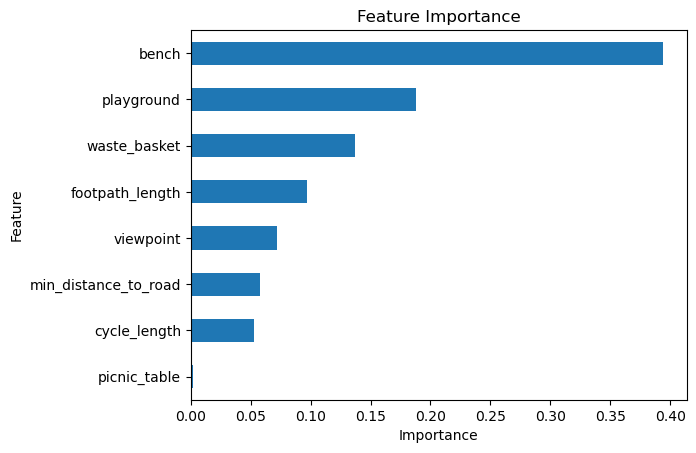

In [478]:
import matplotlib.pyplot as plt

label_importances = pd.Series(best_rf_classifier.feature_importances_, index=X_train.columns)
label_importances.sort_values(ascending=True, inplace=True)
label_importances.plot.barh()
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.title("Feature Importance")

Test with area

In [479]:
label_gdf_rf = label_gdf.drop(columns=['id_left', 'geometry', 'landcover_left', 'landuse_left', 'name_left'])

In [480]:
# Split the data into features (X) and target (y)
X = label_gdf_rf.drop('is_public', axis=1)
y = label_gdf_rf['is_public']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [481]:
rf = RandomForestClassifier(random_state=42)
rf.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [482]:
y_pred = rf.predict(X_test)

In [483]:
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.84375


In [484]:
# check param_grid again

param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [5, 10, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

grid_search = GridSearchCV(estimator=rf, 
                           param_grid=param_grid, 
                           cv=5, 
                           n_jobs=-1)

grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [5, 10, None],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [100, 200, 300]})

In [485]:
print("Best parameters:", grid_search.best_params_)
print("Best cross-validation score:", grid_search.best_score_)

Best parameters: {'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
Best cross-validation score: 0.8436781609195402


In [486]:
best_rf_classifier = grid_search.best_estimator_
y_pred_best = best_rf_classifier.predict(X_test)

print("\nBest Model Accuracy:", accuracy_score(y_test, y_pred_best))
print("\nBest Model Classification Report:\n", classification_report(y_test, y_pred_best))


Best Model Accuracy: 0.8529411764705882

Best Model Classification Report:
               precision    recall  f1-score   support

           0       0.83      0.95      0.89       330
           1       0.90      0.71      0.79       214

    accuracy                           0.85       544
   macro avg       0.87      0.83      0.84       544
weighted avg       0.86      0.85      0.85       544



Text(0.5, 1.0, 'Feature Importance')

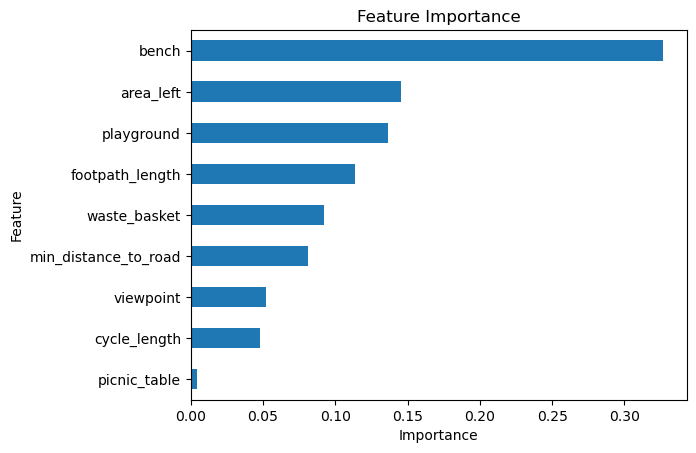

In [487]:
import matplotlib.pyplot as plt

label_importances = pd.Series(best_rf_classifier.feature_importances_, index=X_train.columns)
label_importances.sort_values(ascending=True, inplace=True)
label_importances.plot.barh()
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.title("Feature Importance")

# Predicted unlabeled polygons

In [488]:
unlabel_gdf.columns

Index(['id_left', 'name_left', 'geometry', 'area_left', 'landcover_left',
       'landuse_left', 'is_public', 'bench', 'waste_basket', 'picnic_table',
       'playground', 'footpath_length', 'cycle_length', 'min_distance_to_road',
       'viewpoint'],
      dtype='object')

In [489]:
unlabel_gdf_rf = unlabel_gdf.drop(columns=['id_left', 'geometry', 'landcover_left', 'is_public', 'landuse_left', 'name_left'])

In [490]:
unlabel_y_predict = best_rf_classifier.predict(unlabel_gdf_rf)

In [491]:
len(unlabel_y_predict)

14264

In [492]:
unlabel_gdf.loc[:, 'is_public'] = unlabel_y_predict

In [493]:
print("public:", len(unlabel_gdf[unlabel_gdf['is_public'] == 1]))
print("private:", len(unlabel_gdf[unlabel_gdf['is_public'] == 0]))

public: 1100
private: 13164


In [494]:
# unlabel_gdf.explore(column='is_public', categorical=True, cmap=colors,legend=True)

---